<a href="https://colab.research.google.com/github/piotrbrendan/pm25_forecast_multioutput_time_series/blob/master/PM25_forecast_lstm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Package install + imports

In [ ]:
! python --version

Python 3.7.12


In [ ]:
! pip install -U dataprep
! pip install holidays==0.12
! pip install pandas-profiling==3.1.0
! pip install pytorch_lightning==1.5.8

In [ ]:
from typing import Tuple, List, Sequence, Dict
from dataclasses import dataclass, asdict
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import holidays
from holidays.utils import list_supported_countries, CountryHoliday
import torch
from torch import nn
from torch import Tensor
import pytorch_lightning as pl
import torch.nn.functional as F
import torch.optim as optim
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, LabelEncoder
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint
from pytorch_lightning.utilities.seed import seed_everything

# aestetics config
sns.set_style('whitegrid', rc={'grid.color':'lightgray', 'grid.linestyle':':'})
sns.set_context("notebook", rc={"font.size":14,"axes.titlesize":15,"axes.labelsize":11, 'grid.linewidth':0.75})
sns.set_palette('colorblind')
%matplotlib inline
%load_ext tensorboard

seed_everything(123)

Global seed set to 123


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


123

# Downloading data 

In [ ]:
# for dev - connecting with google drive 
# from google.colab import drive
# drive.mount('/content/gdrive')
# from pydrive.auth import GoogleAuth
# from pydrive.drive import GoogleDrive
# from google.colab import auth
# from oauth2client.client import GoogleCredentials

# auth.authenticate_user()
# gauth = GoogleAuth()
# gauth.credentials = GoogleCredentials.get_application_default()
# drive = GoogleDrive(gauth)

Mounted at /content/gdrive


In [ ]:
! wget https://archive.ics.uci.edu/ml/machine-learning-databases/00394/FiveCitiePMData.rar
! unrar e -ad FiveCitiePMData.rar

--2022-01-16 10:51:54--  https://archive.ics.uci.edu/ml/machine-learning-databases/00394/FiveCitiePMData.rar
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3389986 (3.2M) [application/x-httpd-php]
Saving to: ‘FiveCitiePMData.rar’

FiveCitiePMData.rar 100%[===================>]   3.23M  7.64MB/s    in 0.4s    

2022-01-16 10:51:55 (7.64 MB/s) - ‘FiveCitiePMData.rar’ saved [3389986/3389986]


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from FiveCitiePMData.rar

Creating    FiveCitiePMData                                           OK
Extracting  FiveCitiePMData/ShenyangPM20100101_20151231.csv                0%  1%  2%  3%  4%  5%  6%  7%  8%  9% 10% 11% 12% 13% 14% 15% 16% 17% 18%  OK 
Extracting  FiveCitiePMD

In [ ]:
@dataclass
class CityDFs:
    beijing: pd.DataFrame = pd.DataFrame()
    chengdu: pd.DataFrame = pd.DataFrame()
    guangzhou: pd.DataFrame = pd.DataFrame()
    shanghai: pd.DataFrame = pd.DataFrame()
    shenyang: pd.DataFrame = pd.DataFrame()
    
def load_data(fpath):
    citydfs = CityDFs()
    base_path = Path(fpath)
    for p in base_path.iterdir():
        df = pd.read_csv(str(p), index_col='No')
        df.columns = df.columns.str.lower().str.replace(' ', '_')
        
        df['pm_mean'] = df.filter(regex='^pm_.*').agg('mean', axis=1) # it will skip na by default
        
        # setting to hourly index
        date_idx = pd.PeriodIndex(year=df['year'], month=df['month'], day=df['day'], hour=df['hour'], freq='H')
        df = df.set_index(date_idx)

        # store dfs in dataclass
        city_name = p.name[:p.name.find('PM')].lower()
        setattr(citydfs, city_name, df)
    return citydfs 

citydfs = load_data('FiveCitiePMData')

# EDA

## PM2.5 overview for all cities
Plots below use average value of PM2.5 from all available measurement stations per city (data is consistent among stations in cities)

1. WHO air quality guideline for PM2.5 average annual concetration equals 5 µg/m3 (as of 2021).
Quick glance at below graphs shows how far were all below mentioned cities from reaching that goal.

2. Biggest PM2.5 pollution problems are observable in Beijing and Chengdu.  

3. There is seasonality in PM2.5 data: 
  - annual patterns are consistent among all cities: higher PM2.5 concentrations are observed during cooler seasons, while PM2.5 pollutions dip during summertime. However, the impact of season is different among cities: higher annual volatility is observed for Beijing, Chengdu and Shenyang than for Guangzhou and Shanghai. Most probably this is due to climate differences between cities and resulting winter heating.
  - there are also daily patterns for some cities:
  Beijing exposes higher daily fluctuations during cooler periods (with peak PM2.5 around 21 due to winter heating), in some of the cities there was a dip observable in the early afternoon (maybe road traffic is lower during this periods - for further investigation).   

4. Based on below visuals which compare PM2.5 measurement data between Chinese cities, I have decided that for modeling purposes I will use Beijing data. This city has the longest measurement history. Besides, volatility is high which makes prediction task more nuanced and interesting. 

Combining all cities into 1 model would be in my opinion not appropriate since: geographical distances between them are in thousands of kilometers (see map: https://www.google.com/maps/d/u/0/edit?mid=1wsANDu6iPr8b_a_lVMnGqNd1i7wmFlQ9&usp=sharing) causing significant difference in their climate zone, economic role, day length and even solar time (China has only one time zone although its teritorry spans few geographical timezones). 

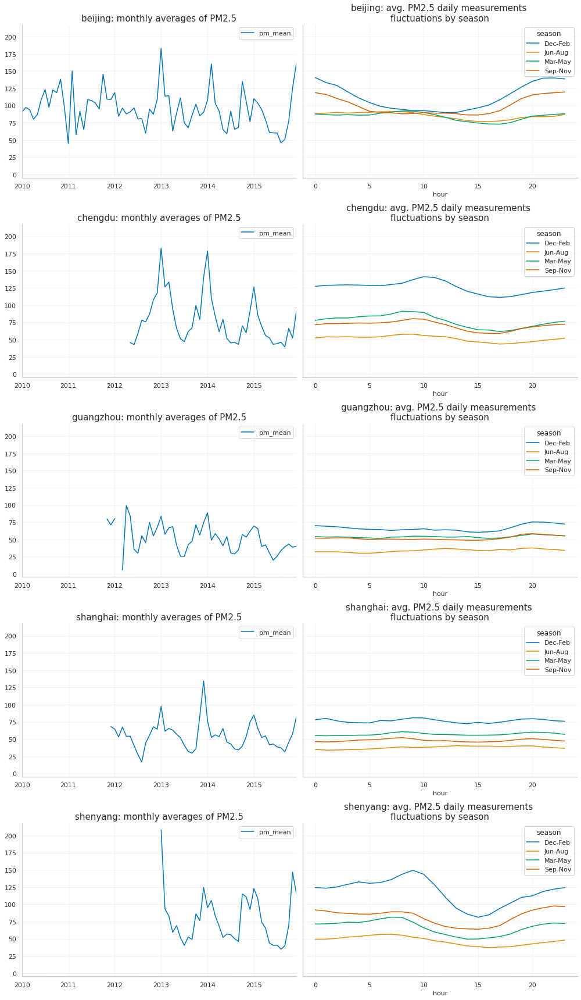

In [ ]:
def plot_cities_comparision(citydfs):
    fig, axs = plt.subplots(5,2, figsize=(14,24), sharey=True)
    axs = axs.ravel()
    for ax_idx, cities in enumerate(asdict(citydfs).items()):
        city_name, df = cities
        df.resample('M').mean().plot(y=['pm_mean'], ax=axs[ax_idx*2], title=f'{city_name}: monthly averages of PM2.5')
        
        season_mapper = {1:'Mar-May', 2:'Jun-Aug', 3:'Sep-Nov', 4:'Dec-Feb'}
        df['season'] = df['season'].map(season_mapper)
        df.groupby(['hour', 'season'])['pm_mean'].mean().unstack().plot(ax=axs[ax_idx * 2 + 1], title=f'{city_name}: avg. PM2.5 daily measurements \nfluctuations by season')
    plt.tight_layout()
    sns.despine()

plot_cities_comparision(citydfs)

## Beijing: wind vs PM2.5
Scatter plot shows strong relationship between wind speed and air pollution in Beijing.
- Higher wind speed can be associated with lower pollution levels and the relationship is non-linear: small increase in wind speed correlates with high decrease in PM2.5 
- Interestingly, wind speed is correlated with its direction: Stronger wind comes usually from north-west. 
- The lightest wind is tagged in data as 'cv': this is probably a tag for no dominant direction (this is just a guess, I did not find answer for that in the documentation).

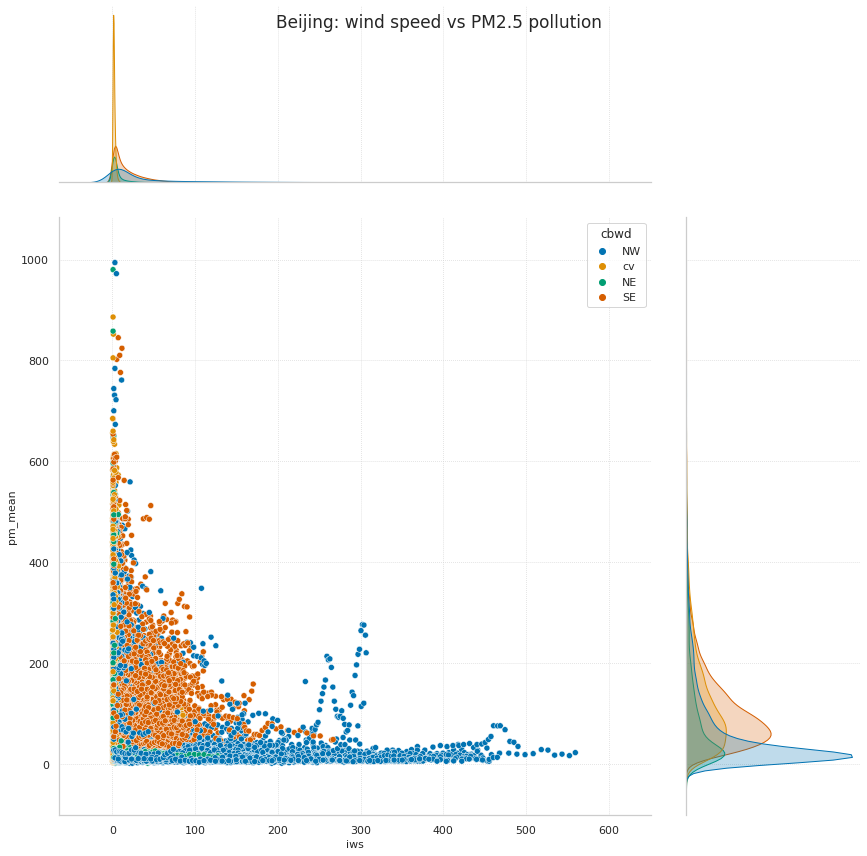

In [ ]:
def plot_wind_vs_pm25(df):
    jp = sns.jointplot(data=df, y='pm_mean', x='iws', hue='cbwd', height=12, ratio=3, palette='colorblind',)
    jp.fig.suptitle("Beijing: wind speed vs PM2.5 pollution", size=17)

plot_wind_vs_pm25(citydfs.beijing)    

## Checks of data quality, distributions, correlations and missings for modeling purposes


DataPrep Report
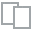
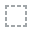
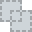
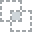
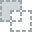
...
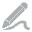
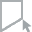
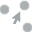
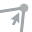
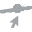

In [ ]:
from dataprep.eda import create_report
create_report(citydfs.beijing)

# MODELING

### Assumptions/remarks for modeling task

## Task definition and target variable:
Based on the last 24h of data, model will produce output with forecast of 
PM2.5 concentration in Beijing for the incoming 6 hours. 
Target is mean PM2.5 measure from all stations in Beijing (according to paper data is consistent among measurement stations, so we can aggregate it)
This is a task of multiinput time series that return multioutput therefore I find it useful to build deep learning model: specifically lstm.


## Data preparation steps:

1. Dealing with nulls: 
- interpolation of numeric data (both input and output) - simple linear interpolation to deal with nulls was utilized (nulls were not problematic, not too many and not very concentrated)
- categorical data null imputations with mode
3. Feature engineering:
- adding more time-related features like: is_weekend_flg, is_holiday_flg (public holidays based on Chinese calendar), day_of_week 
- sine and cosine cyclical features transformation (hours, day, month). It causes the distances between any given hours reflect their time diffs (eg. distance between 23:00 and 1:00 is 2 hours which is preserved thanks to that transformation). I treat season, day_of_week as categorical variables due to low cardinality.
- categorical data preparation as embeddings (https://arxiv.org/pdf/1604.06737.pdf)
- standard scaling for most numeric features to achieve stable and faster model convergence + log transformation of target, iws and precipitation feature (to mitigate highly skewed distributions)

## Model architecture

- embeddings layers for all categorical features, table below shows embedding dimentions for chosen features.

```markdown
Feature        | levels_cnt | embedding_dimention
---------------|------------|--------------------
season	     | 4	      | 4
cbwd	       | 4	      | 4
day_of_week	| 7          | 4
weekend_flg    | 2	      | 2
holidays_flg   | 2	      | 2
```

- 1 LSTMs  
- 1 fully connected dense output layer

```markdown
Layer no  |  Name      | Type        | Params 
----------|------------|-------------|---------
0         | emb_layers | ModuleList  | 68    
1         | lstm       | LSTM        | 15.2 K
2         | out        | Linear      | 294   
-----------------------------------------------
15.5 K    Trainable params
0         Non-trainable params
15.5 K    Total params
0.062     Total estimated model params size (MB) 
```

I have tried also more sofisticated architectures with 2 stacked LSTM + more hidden units and additional dense layer, but it was an overkill: fitting took much more time and model had tendency to overfit. Therefore I have decided to stick to simpler architecture.

## Training and evaluation procedure 
Training data
Date range: < 2015-06-01

Validation data:
Date range: 2015-06-01 - 2015-10-31

Test data
Date range: 2015-01-11 - 2015-12-31

<!-- I do not introduce validation set, since I will not do here any hyperparameter optimization (for a sake of brevity) -->

Evaluation:
I have introduced simple baseline forecast based on moving average of the last 5 observations for any given hour i.e. to predict PM2.5 at 6 pm I use average of 5 previous days data at 6 pm (it tires to cover daily patterns which are visible in Beijing data). 
Model results will be compared with this naive baseline to see if there is any improvment. 
I will not compare different modeling techniques or DL architectures here (which should be the case in a real task).

For production environment different approach to null treatment must be implemented + unseen categorical data levels should be served with caution. Hyperparameter tuning is restricted to learning rate finder and reducing learning rate on plateau. Other hyperparams were only checked manually.

Results on test set are presented at the end and compared to baseline forecast.  


## Modeling data prep

In [ ]:
model_df = citydfs.beijing.copy()

Checking nulls

In [ ]:
model_df.isnull().sum(axis=0)

year                   0
month                  0
day                    0
hour                   0
season                 0
pm_dongsi          27532
pm_dongsihuan      32076
pm_nongzhanguan    27653
pm_us_post          2197
dewp                   5
humi                 339
pres                 339
temp                   5
cbwd                   5
iws                    5
precipitation        484
iprec                484
pm_mean             1894
dtype: int64

In [ ]:
model_df['pm_mean'].isnull().astype(int).resample('3M').sum().head(60)

2010-01    126
2010-04    164
2010-07    320
2010-10     59
2011-01    191
2011-04    224
2011-07    178
2011-10    134
2012-01     84
2012-04     66
2012-07    185
2012-10    156
2013-01      4
2013-04      0
2013-07      2
2013-10      0
2014-01      0
2014-04      0
2014-07      1
2014-10      0
2015-01      0
2015-04      0
2015-07      0
2015-10      0
Freq: 3M, Name: pm_mean, dtype: int64

### Drop unuseful variables for modeling

In [ ]:
# removal iprec: this is perfectly correlated variable with precipitation - they show same value but iprec is an aggregate. 
# I will use hourly precipitation for modeling 

model_df = model_df.drop(['pm_dongsi', 'pm_dongsihuan','pm_nongzhanguan', 'pm_us_post'], axis=1)
model_df = model_df.drop(['year', 'iprec'], axis=1)

### train/valid/test set

Train set: till 2015-07-01 <br>
Valid set: Summer and autumn 2015 <br>
Test set: 2015-11-15 - 2015-12 (winter time is crucial for model) <br> 


In [ ]:
TRAIN_DATE_END = '2015-06-01'
VALID_DATE_END = '2015-10-31'
TEST_DATE_END = '2016-01-01'

# past 24h data as a training sequence
SEQUENCE_LEN = 24
# 6h of data as output
OUTPUT_LEN = 6
BATCH_SIZE = 64 

In [ ]:
train_df = model_df[(model_df.index < TRAIN_DATE_END)]
valid_df = model_df[(model_df.index >= TRAIN_DATE_END) & (model_df.index < VALID_DATE_END)]
test_df = model_df[(model_df.index >= VALID_DATE_END) & (model_df.index < TEST_DATE_END)]

### Null imputations, feature engineering, data scaling, encoding and embeddings prep for categorical features 


In [ ]:
numeric_cols_df = model_df.select_dtypes(exclude='object')
numeric_cols_to_impute = list(numeric_cols_df.loc[:,numeric_cols_df.isnull().sum() > 0].columns)

numeric_cols_to_impute

['dewp', 'humi', 'pres', 'temp', 'iws', 'precipitation', 'pm_mean']

In [ ]:
cat_cols_df = model_df.select_dtypes(include='object')
cat_cols_to_impute = list(cat_cols_df.loc[:, cat_cols_df.isnull().sum() > 0].columns)

cat_cols_to_impute

['cbwd']

In [ ]:
cat_to_encode_lst = model_df.select_dtypes('object').columns
cat_to_encode_lst

Index(['cbwd'], dtype='object')

Feature eng functions:

- adding day_of_week variable
- adding is_weekend_flg
- adding public holidays flg
- adjusting day, month and season to start from 0 (required by sine, cosine transformation) and embeddings 
- sine and cosine transformations for cyclical data

In [ ]:
def prep_features(df: pd.DataFrame) -> pd.DataFrame:
    
    dfc = df.copy()
    
    dfc['day_of_week'] = dfc.index.dayofweek
    dfc['weekend_flg'] = dfc['day_of_week'].isin([5,6]).astype(int) 
    holidays_series = get_chinese_holidays(dfc) 
    dfc = pd.concat([dfc, holidays_series], axis=1)

    # adjustments to cyclical variables to start from 0
    for col in ['season', 'month', 'day']:
        dfc[col] -= 1 

    # add new cols sine cosine transformation 
    for col in ['month', 'hour', 'day']:
        sin_col, cos_col = sin_cos_transform(model_df[col])
        dfc = dfc.assign(**{f'{col}_sin':sin_col, f'{col}_cos':cos_col})
    
    return dfc

def get_chinese_holidays(df: pd.DataFrame) -> pd.Series:
    dfc = df.copy()
    china_holidays = CountryHoliday('CN')
    if_holidays = np.vectorize(lambda x: int(x in china_holidays))
    return pd.Series(dfc.index.strftime('%Y-%m-%d'), index=dfc.index, name='holidays_flg').apply(if_holidays)    

def sin_cos_transform(col: pd.Series) ->  Tuple[pd.Series, pd.Series]:
    """Applies sine and cosine transformations col to reflect cyclical character.
    Requires input value to start from 0.
    """
    base = (col * 2*np.pi/col.nunique())
    return np.sin(base), np.cos(base)


Prep train data functions

In [ ]:
def prep_train_df(train_df: pd.DataFrame
                  , numeric_cols_to_impute: List[str]
                  , cat_cols_to_impute: List[str]
                  , cat_cols_to_encode: List[str]) -> Tuple[np.array, Dict]:

    train_dfc = train_df.copy() 
    preprocessors = {'mode_imputer': None,
                    'label_enc': None,
                    'scaler': None}

    train_dfc = impute_numeric(train_dfc, numeric_cols_to_impute)
    train_dfc, preprocessors['mode_imputer'] = impute_categorical_train(train_dfc, cat_cols_to_impute)
    print(train_dfc.head(5))
    train_dfc = prep_features(train_dfc)
    train_dfc, preprocessors['label_enc'] = encode_cat_features_train(train_dfc, cat_cols_to_encode)
    cat_features = ['season', 'cbwd', 'day_of_week', 'weekend_flg', 'holidays_flg']
    num_features = ['month_sin', 'month_cos', 'hour_sin', 'hour_cos', 'day_sin', 'day_cos'
                    ,'precipitation', 'iws', 'temp', 'pres', 'humi', 'dewp', 'pm_mean']
    
    emb_sizes = prep_emb_sizes(train_dfc, cat_features)
    num_features_arr, preprocessors['scaler'] = scale_numeric_data_train(train_dfc, num_features)
    cat_features_arr = train_dfc[cat_features].to_numpy()
    train_arr = np.concatenate([cat_features_arr, num_features_arr], axis=1)
    return train_arr, preprocessors, emb_sizes


def impute_numeric(df: pd.DataFrame, numeric_cols_to_impute: List[str]) -> pd.DataFrame:
    
    dfc = df.copy()
    return dfc.assign(**{
        colname: df[colname].interpolate(limit_area=None, limit_direction='both') 
        for colname in numeric_cols_to_impute
        })


def impute_categorical_train(train_df: pd.DataFrame, cat_cols_to_impute: List[str]) -> Tuple[pd.DataFrame, SimpleImputer]: 
    
    train_dfc = train_df.copy()
    for col in cat_cols_to_impute:
        train_dfc[col] = train_dfc[col].str.lower()

    mode_imputer = SimpleImputer(strategy='most_frequent')
    train_dfc.loc[:, cat_cols_to_impute] = mode_imputer.fit_transform(train_dfc[cat_cols_to_impute])
    return train_dfc, mode_imputer


def encode_cat_features_train(train_df: pd.DataFrame, cat_to_encode_lst: List[str]) -> Tuple[pd.DataFrame, LabelEncoder]:
    
    train_dfc = train_df.copy()
    label_enc = LabelEncoder()
    train_dfc[cat_to_encode_lst] = label_enc.fit_transform(train_dfc[cat_to_encode_lst])
    return train_dfc, label_enc


def scale_numeric_data_train(train_df: pd.DataFrame, num_features: List[str]) -> Tuple[np.array, StandardScaler]:
    
    sc = StandardScaler()
    train_dfc = train_df.copy()
    
    num_features_log = ['iws', 'precipitation', 'pm_mean']
    num_features_scaler = list(set(num_features) - set(num_features_log)) 

    num_features_scaler_arr = sc.fit_transform(train_dfc[num_features_scaler])
    num_features_log_arr = np.log(train_dfc[num_features_log] + 1)
    return np.concatenate([num_features_scaler_arr, num_features_log_arr], axis=1), sc

def prep_emb_sizes(train_df: pd.DataFrame, cat_features: List[str]) -> pd.DataFrame:
    # sources https://forums.fast.ai/t/embedding-layer-size-rule/50691
    # https://towardsdatascience.com/deep-embeddings-for-categorical-variables-cat2vec-b05c8ab63ac0
    # implemented with slight modification 
    cat_cnt = train_df[cat_features].nunique() 
    cat_df = pd.DataFrame(cat_cnt, columns=['levels_cnt'])
    cat_df['emb_dim'] = cat_cnt.apply(lambda x: min(50, (x+1)//2) if x > 4 else x)   
    return cat_df

Test data prep functions

In [ ]:
def prep_test_df(test_df
                , numeric_cols_to_impute
                , cat_cols_to_impute
                , cat_cols_to_encode
                , preprocessors):
    
    test_dfc = test_df.copy()
    test_dfc = impute_numeric(test_dfc, numeric_cols_to_impute)
    test_dfc = impute_categorical_test(preprocessors['mode_imputer'], test_dfc, cat_cols_to_impute)
    test_dfc = prep_features(test_dfc)

    
    test_dfc = encode_cat_features_test(preprocessors['label_enc'], test_dfc, cat_cols_to_encode)
    
    cat_features = ['season', 'cbwd', 'day_of_week', 'weekend_flg', 'holidays_flg']
    num_features = ['month_sin', 'month_cos', 'hour_sin', 'hour_cos', 'day_sin', 'day_cos'
                    ,'precipitation', 'iws', 'temp', 'pres', 'humi', 'dewp', 'pm_mean']

    num_features_arr = scale_numeric_data_test(preprocessors['scaler'], test_dfc, num_features)
    cat_features_arr = test_dfc[cat_features].to_numpy()
    test_arr = np.concatenate([cat_features_arr, num_features_arr], axis=1)
    
    return test_arr


def impute_categorical_test(imputer, test_df: pd.DataFrame, cat_cols_to_impute: List[str]) -> pd.DataFrame: 
    test_dfc = test_df.copy()
    for col in cat_cols_to_impute:
        test_dfc[col] = test_dfc[col].str.lower()
    
    test_dfc.loc[:, cat_cols_to_impute] = imputer.transform(test_dfc[cat_cols_to_impute])
    return test_dfc

def encode_cat_features_test(label_enc, test_df, cat_to_encode):
    test_dfc = test_df.copy()
    test_dfc[cat_to_encode_lst] = label_enc.transform(test_dfc[cat_to_encode_lst])
    return test_dfc


def scale_numeric_data_test(sc, test_df: pd.DataFrame, cont_features) -> np.array:
    cont_features_log = ['iws', 'precipitation', 'pm_mean']
    cont_features_scaler = list(set(cont_features) - set(cont_features_log)) 

    cont_features_scaler_arr = sc.transform(test_df[cont_features_scaler])
    cont_features_log_arr = np.log(test_df[cont_features_log] + 1)
    return np.concatenate([cont_features_scaler_arr, cont_features_log_arr], axis=1)

Generate data for modeling

In [ ]:
train_arr, preprocesors, emb_sizes = prep_train_df(train_df, numeric_cols_to_impute, cat_cols_to_impute, cat_to_encode_lst)
valid_arr, test_arr = [prep_test_df(df, numeric_cols_to_impute, cat_cols_to_impute, cat_to_encode_lst, preprocesors)
                     for df in [valid_df, test_df]]

                  month  day  hour  season  ...  cbwd    iws  precipitation  pm_mean
2010-01-01 00:00      1    1     0       4  ...    nw   1.79            0.0    129.0
2010-01-01 01:00      1    1     1       4  ...    nw   4.92            0.0    129.0
2010-01-01 02:00      1    1     2       4  ...    nw   6.71            0.0    129.0
2010-01-01 03:00      1    1     3       4  ...    nw   9.84            0.0    129.0
2010-01-01 04:00      1    1     4       4  ...    nw  12.97            0.0    129.0

[5 rows x 12 columns]


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


### Prepare Datasets and Dataloaders to feed Pytorch model

TimeSeriesDataset: custom Dataset that provides sequences of input and output data

In [ ]:
pd.isnull(valid_arr).sum(), pd.isnull(train_arr).sum(), pd.isnull(test_arr).sum()

(0, 0, 0)

In [ ]:
class TimeseriesDataset(torch.utils.data.Dataset):
    def __init__(self
                 , X: np.array
                 , cat_col_idxs: Sequence[int]
                 , num_col_idxs: Sequence[int] 
                 , y: np.array
                 , seq_len:int
                 , output_len:int=1):
        
        self.X = X
        self.cat_col_idxs = cat_col_idxs
        self.num_col_idxs = num_col_idxs
        self.y = y
        self.seq_len = seq_len
        self.output_len = output_len

    @property
    def output_len(self):
        return self._output_len

    @output_len.setter
    def output_len(self, new_len):
        if new_len < 1:
            raise ValueError('output len must be >=1')
        self._output_len = new_len


    def __len__(self):
        return len(self.X) - self.seq_len - self.output_len + 1

    def __getitem__(self, idx):
        
        y_batch = torch.from_numpy(self.y[idx+self.seq_len: idx+self.output_len+self.seq_len].reshape(-1)).float()
        x_cat_batch = torch.from_numpy(self.X[idx:idx+self.seq_len, self.cat_col_idxs]).long()
        x_num_batch = torch.from_numpy(self.X[idx:idx+self.seq_len, self.num_col_idxs]).float() 

        return ((x_cat_batch, x_num_batch), y_batch)

In [ ]:
train_dataset = TimeseriesDataset(train_arr, cat_col_idxs=range(5), num_col_idxs=range(5,18), y=train_arr[:,-1] , seq_len=SEQUENCE_LEN, output_len=OUTPUT_LEN)
valid_dataset = TimeseriesDataset(valid_arr, cat_col_idxs=range(5), num_col_idxs=range(5,18), y=valid_arr[:,-1], seq_len=SEQUENCE_LEN, output_len=OUTPUT_LEN)
test_dataset = TimeseriesDataset(test_arr, cat_col_idxs=range(5), num_col_idxs=range(5,18), y=test_arr[:,-1], seq_len=SEQUENCE_LEN, output_len=OUTPUT_LEN)

In [ ]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = torch.utils.data.DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

Check shapes of data provided to model

In [ ]:
check = next(iter(train_loader))
check[0][0].shape, check[0][1].shape, check[1].shape

check = next(iter(valid_loader))
check[0][0].shape, check[0][1].shape, check[1].shape

(torch.Size([64, 24, 5]), torch.Size([64, 24, 13]), torch.Size([64, 6]))

## Model definition
I have decided to use Pythorch Lightning for modeling.
I do not do any hyperparam optimization apart from learnig rate.

In [ ]:
class LSTMReggressor(pl.LightningModule):
    
    def __init__(self 
                 , learning_rate
                 , weight_decay
                 , lstm_dropout
                 , emb_sizes
                 , cont_features_no
                 , seq_len
                 , n_layers
                 , n_hidden
                 , out_len): 

        super(LSTMReggressor, self).__init__()
        
        self.learning_rate = learning_rate
        self.weight_decay = weight_decay
        self.lstm_dropout = lstm_dropout
        self.emb_sizes = emb_sizes
        self.cont_total_size = cont_features_no 
        self.seq_len = seq_len
        
        self.n_layers = n_layers
        self.n_hidden = n_hidden
        self.out_len = out_len 
        
        self.embs_total_size = sum(y for _, y in emb_sizes)
        self.total_feature_size = self.embs_total_size + self.cont_total_size
        self.emb_layers = nn.ModuleList([nn.Embedding(cat_size, emb_size)
                                               for cat_size, emb_size in self.emb_sizes ])
        
        self.lstm = nn.LSTM(input_size=self.total_feature_size,
                            hidden_size = self.n_hidden,
                            num_layers = self.n_layers, 
                            dropout=self.lstm_dropout,
                            batch_first=True)
        self.out = nn.Linear(self.n_hidden, self.out_len)
        self.save_hyperparameters()
        
    def forward(self, batch_data):
        cat_data, cont_data = batch_data
        x=[]
        for cat_idx, emb_layer in enumerate(self.emb_layers):
            x_per_seq = [emb_layer(cat_data[:, seq_idx, cat_idx]) for seq_idx in range(self.seq_len)] 
            x.append(torch.stack(x_per_seq).swapaxes(0,1))
        
        x = torch.cat(x, -1)    
        x = torch.cat([x, cont_data], -1).float()
        _, (h_out, _) = self.lstm(x) 
        h_out = h_out[-1].view(-1, self.n_hidden)
        return self.out(h_out)

    def configure_optimizers(self): 
        optimizer = torch.optim.AdamW(self.parameters(), lr=self.learning_rate, weight_decay=self.weight_decay)
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": optim.lr_scheduler.ReduceLROnPlateau(factor=0.1
                                                                , patience=1
                                                                , min_lr=1e-07
                                                                , optimizer=optimizer),
                "monitor": "val_loss",
                "frequency": 1
                },
            }

        return optimizer

    def training_step(self, train_batch, batch_idx):
        x, y = train_batch
        y_hat = self(x)   
        loss = F.mse_loss(y_hat, y)
        self.log('train_loss', loss)
        return loss

    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('val_loss', loss)

    def test_step(self, test_batch, batch_idx):
        x, y = test_batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('test_loss', loss) 

    def predict_step(self, batch, batch_idx, dataloader_idx=0):
        return self(batch[0])

In [ ]:
lr_monitor = LearningRateMonitor(logging_interval='epoch')
model_checkpoint = ModelCheckpoint(monitor='val_loss', save_top_k=2) # saves only 2 best models

# model
model = LSTMReggressor(learning_rate=1e-04 #this will be updated by lr_finder
                       , weight_decay=0.01
                       , lstm_dropout=0.
                       , emb_sizes=emb_sizes.values
                       , cont_features_no=13
                       , seq_len=SEQUENCE_LEN
                       , n_layers=1
                       , n_hidden=48
                       , out_len=OUTPUT_LEN)

# if on machine with GPU uncomment below
#trainer = pl.Trainer(callbacks=[lr_monitor], gpus=1, accelerator='gpu', max_epochs=20)
trainer = pl.Trainer(callbacks=[lr_monitor, model_checkpoint], max_epochs=20) 

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


## Fitting model

Learning rate finder to get good starting point.
Learning rate will be reduced if validation loss does not improve after each epoch (see ReduceLROnPlateau)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Global seed set to 123


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

Restoring states from the checkpoint path at /content/lr_find_temp_model_b7a15604-91ac-472d-af18-70a8f45566b8.ckpt


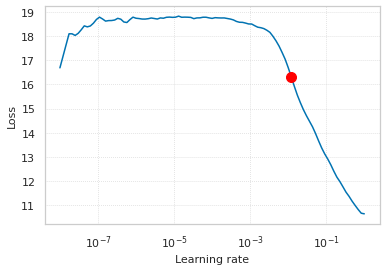

In [ ]:
# https://pytorch-lightning.readthedocs.io/en/latest/advanced/lr_finder.html
lr_finder = trainer.tuner.lr_find(model, train_loader, valid_loader)
fig = lr_finder.plot(suggest=True)


In [ ]:
model.learning_rate = lr_finder.suggestion()
model.learning_rate

0.012022644346174132

In [ ]:
# Restoring saved model to my drive
# MODEL_PATH = Path('/content/gdrive/MyDrive/smartpatient_task/final_version/checkpoints/epoch=10-step=8150.ckpt')
# HPARAMS_PATH = Path('/content/lightning_logs/final_version/hparams.yaml')
# model = LSTMReggressor.load_from_checkpoint(str(MODEL_PATH), hparams_file=str(HPARAMS_PATH))

In [ ]:
trainer.fit(model, train_loader, valid_loader) 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params
------------------------------------------
0 | emb_layers | ModuleList | 68    
1 | lstm       | LSTM       | 15.2 K
2 | out        | Linear     | 294   
------------------------------------------
15.5 K    Trainable params
0         Non-trainable params
15.5 K    Total params
0.062     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 123


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
# see logs from training in tensorboard
%tensorboard --logdir lightning_logs

<IPython.core.display.Javascript object>

In [ ]:
# ! cp -r /content/lightning_logs/final_version /content/gdrive/MyDrive/smartpatient_task/

In [ ]:
trainer.callbacks[0].lrs

{'lr-AdamW': [0.012022644346174132,
  0.012022644346174132,
  0.012022644346174132,
  0.012022644346174132,
  0.012022644346174132,
  0.0012022644346174132,
  0.0012022644346174132,
  0.00012022644346174132,
  0.00012022644346174132,
  0.00012022644346174132,
  1.2022644346174133e-05,
  1.2022644346174133e-05,
  1.2022644346174133e-05,
  1.2022644346174134e-06,
  1.2022644346174134e-06,
  1.2022644346174135e-07,
  1.2022644346174135e-07,
  1e-07,
  1e-07,
  1e-07]}

## Validation

I have chosen the best model saved based on lowest val_loss metric

Metric for model validation: MSE

It looks like on test set it generalizes quite well, model did not overfit, I will visualize the results.


In [ ]:
trainer.validate(dataloaders = valid_loader, ckpt_path='best')

Restoring states from the checkpoint path at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt


Validating: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 VALIDATE RESULTS
{'val_loss': 0.1968376636505127}
--------------------------------------------------------------------------------


[{'val_loss': 0.1968376636505127}]

In [ ]:
trainer.test(dataloaders=test_loader, ckpt_path='best')

Restoring states from the checkpoint path at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_loss': 0.21592560410499573}
--------------------------------------------------------------------------------


[{'test_loss': 0.21592560410499573}]

## Generate predictions for eval on test set and analysis

Final metrics: RMSE, MAE, MAPE

In [ ]:
all_preds = trainer.predict(dataloaders=test_loader, ckpt_path='best')

Restoring states from the checkpoint path at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/lightning_logs/version_0/checkpoints/epoch=19-step=14819.ckpt


Predicting: 741it [00:00, ?it/s]

In [ ]:
# getting timespan for predictions:
pred_start = test_df.index.min() + SEQUENCE_LEN 
pred_end = test_df.index.max() - OUTPUT_LEN + 1 
print(pred_start, pred_end)

pred_datetimes = pd.date_range(pred_start.to_timestamp(), pred_end.to_timestamp(), freq='H')

2015-11-01 00:00 2015-12-31 18:00


Inverse transformed target variable to get interpretable PM2.5 values



In [ ]:
y_pred_flat = torch.cat(all_preds,0).exp() - 1
y_true_flat = torch.cat([data[-1] for data in iter(test_loader)], 0).exp() - 1 

## Final metrics calculation for predicted test set

First general metrics are printed. <br>
Below in the table you can see metrics per x-hour step ahead, so for example: 

we have `output prediction = [10,20,30,40,50]`

for row `3_hour_ahead` value `30` is taken from output prediction  and compared with y_true.


In [ ]:
total_rmse_loss_test = np.sqrt(F.mse_loss(y_pred_flat, y_true_flat))
total_mae_loss_test = F.l1_loss(y_pred_flat, y_true_flat)
total_mape_loss_test = ((y_pred_flat - y_true_flat).abs() / y_true_flat.abs()).mean()

print(f'Total RMSE loss on test: {total_rmse_loss_test:.1f} \
        \nTotal MAE loss on test: {total_mae_loss_test:.1f} \
        \nTotal MAPE loss on test: {total_mape_loss_test:.1%}')

Total RMSE loss on test: 64.0         
Total MAE loss on test: 36.0         
Total MAPE loss on test: 42.1%


In [ ]:
step_loss_dct = {}
for step in range(y_pred_flat.shape[1]):
    y_pred_step = y_pred_flat[:,step]
    y_true_step = y_true_flat[:,step]
    rmse_per_step = np.sqrt(F.mse_loss(y_pred_step, y_true_step)).numpy()
    mae_per_step = F.l1_loss(y_pred_step, y_true_step).numpy()
    mape_per_step = ((y_pred_step - y_true_step).abs() / y_true_step.abs()).mean().numpy()

    step_loss_dct[f'{step + 1}_hour_ahead'] = [rmse_per_step, mae_per_step, mape_per_step]

model_metrics_per_hour_step = pd.DataFrame.from_dict(step_loss_dct, orient='index', columns=['rmse_loss', 'mae_loss', 'mape_loss'])

model_metrics_per_hour_step

,rmse_loss,mae_loss,mape_loss
1_hour_ahead,26.06426,14.636976,0.14856271
2_hour_ahead,42.711555,24.460554,0.2666856
3_hour_ahead,57.18502,33.831276,0.38312116
4_hour_ahead,69.14857,41.581142,0.48525563
5_hour_ahead,79.28857,48.14357,0.5793934
6_hour_ahead,88.15641,53.597,0.66130203


As it should be expected model is doing well for 1-2h ahead and later the performance deteriorates.

## Comparing preds with baseline model 

In [ ]:
moving_avg_window = 5
def get_baseline(model_df
                , forecast_start
                , forecast_end
                , moving_avg_window=5):
    
    """Forecast based on simple average of last {moving_avg_window} 
    observations for a given hour ie. accounts for daily seasonality."""
    
    model_dfc = model_df.copy()
    model_dfc['pm_mean_24h_shift'] = model_dfc['pm_mean'].shift(24)
    model_dfc['hour'] = model_dfc.index.hour

    baseline_forecast_df = (
        model_dfc.groupby('hour').rolling(moving_avg_window, min_periods=None)[['pm_mean_24h_shift']]
                .mean().reset_index(level=0)
                .sort_index().drop('hour', axis=1)
    )
    return baseline_forecast_df[forecast_start:forecast_end]

baseline_forecast = get_baseline(model_df, pred_start, pred_end, moving_avg_window)


baseline_rmse = np.sqrt(F.mse_loss(torch.Tensor(baseline_forecast['pm_mean_24h_shift'].values), y_true_flat[:,0]))
print(f'Baseline RMSE equals: {baseline_rmse:.1f}')

Baseline RMSE equals: 151.6


Visualize results for 1 hour ahead lstm forecasts vs actuals vs baseline: 

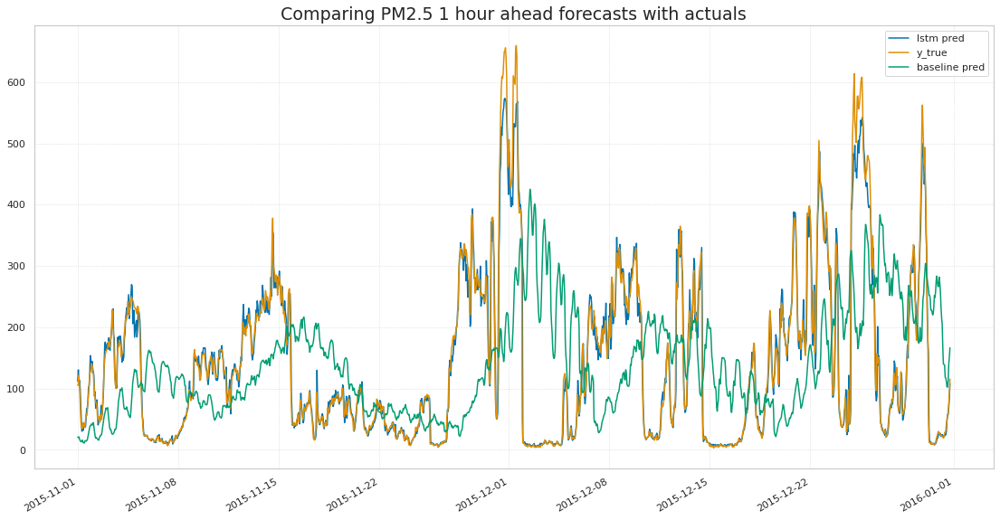

In [ ]:
fig, ax = plt.subplots(figsize=(19, 10))

plt.title('Comparing PM2.5 1 hour ahead forecasts with actuals', size=19)
plt.plot(pred_datetimes, y_pred_flat[:,0], label="lstm pred")
plt.plot(pred_datetimes, y_true_flat[:,0], label='y_true')
baseline_forecast['pm_mean_24h_shift'].plot(label='baseline pred')
plt.legend()

Visualize results for 6th hour ahead lstm forecast vs actuals vs baseline: 

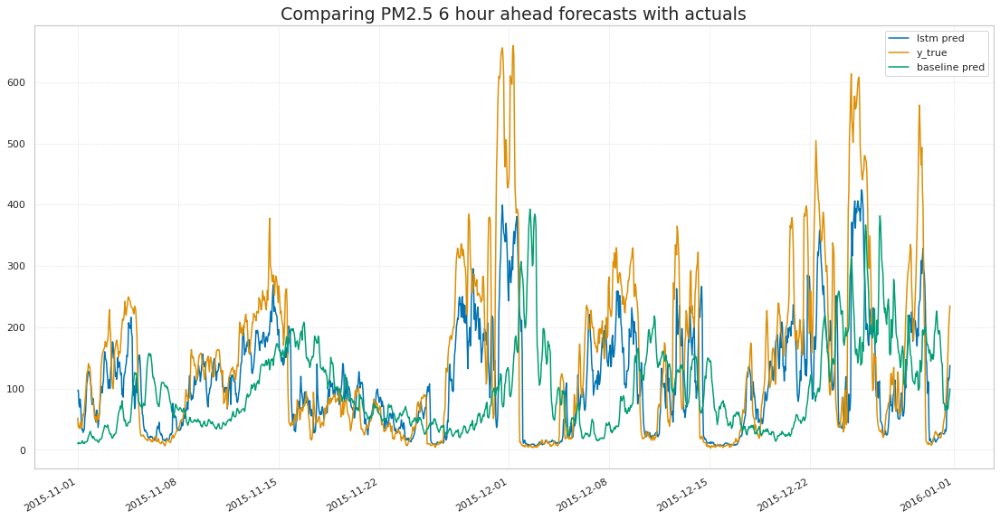

In [ ]:
fig, ax = plt.subplots(figsize=(19, 10))

plt.title('Comparing PM2.5 6 hour ahead forecasts with actuals', size=19)
plt.plot(pred_datetimes, y_pred_flat[:,-1], label="lstm pred")
plt.plot(pred_datetimes, y_true_flat[:,-1], label="y_true")
baseline_forecast['pm_mean_24h_shift'].plot(label="baseline pred")
plt.legend()

Even for last forecasted hour lstm model is much better than naive baseline

Below comparison of residuals for 1h ahead vs baseline

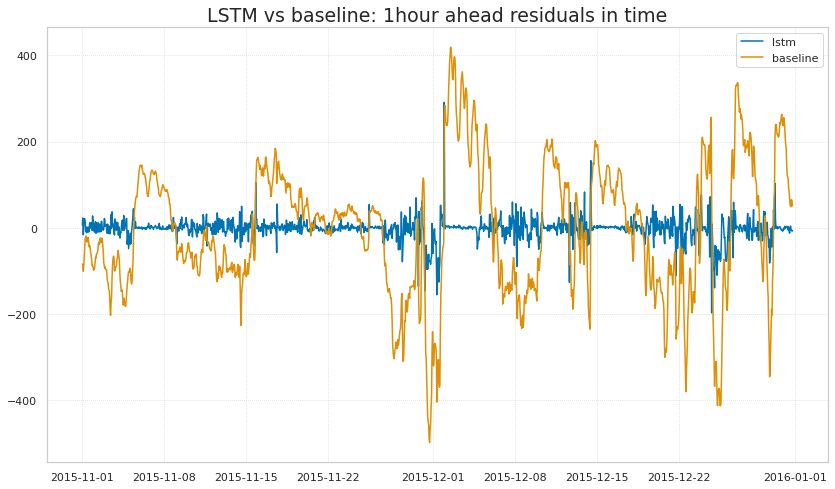

In [ ]:
fig, ax =plt.subplots(figsize=(14,8))
plt.title('LSTM vs baseline: 1hour ahead residuals in time', size=19)
ax.plot(pred_datetimes, ((y_pred_flat[:,0] - y_true_flat[:,0]).numpy()), label='lstm')
ax.plot(pred_datetimes, (baseline_forecast['pm_mean_24h_shift'] - (y_true_flat[:,0]).numpy()), label='baseline')
plt.legend()

Below comparison of residuals histograms: we can see that model residuals for 1 hour ahead forecast behave well with some tendency to underestimation 

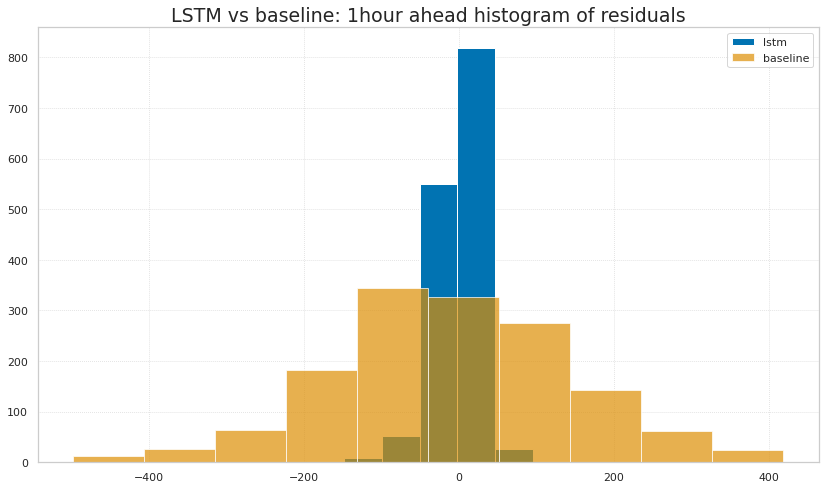

In [ ]:
fig, ax =plt.subplots(figsize=(14,8))
plt.title('LSTM vs baseline: 1hour ahead histogram of residuals', size=19)
ax.hist(((y_pred_flat[:,0] - y_true_flat[:,0]).numpy()), label='lstm')
ax.hist((baseline_forecast['pm_mean_24h_shift'] - (y_true_flat[:,0]).numpy()), label='baseline', alpha=0.7)
plt.legend()

Closing remarks:

More hiperparameter optimization could to be added: especially tuning the length of input sequence seems interesting. 
Besides, comparison of some other architectures could be beneficial.
There is a PyTorch Forecasting library that looks perfect for such a task https://pytorch-forecasting.readthedocs.io/en/stable/index.html (I have spotted it while preparing this one)